In [1]:
import gglasso
import pickle
import numpy as np
import pandas as pd
import seaborn as sns
import scipy as sp
import matplotlib.pyplot as plt

from numpy.linalg import matrix_rank
from matplotlib.pyplot import figure
from scipy import stats
from scipy.linalg import eigh
from numpy import genfromtxt

from gglasso.solver.admm_solver import ADMM_MGL
from gglasso.problem import glasso_problem

from gglasso.helper.data_generation import generate_precision_matrix, group_power_network, sample_covariance_matrix
from gglasso.helper.basic_linalg import adjacency_matrix
from gglasso.helper.data_generation import time_varying_power_network, sample_covariance_matrix
from gglasso.helper.experiment_helper import lambda_grid, discovery_rate, error
from gglasso.helper.utils import get_K_identity
from gglasso.helper.experiment_helper import plot_evolution, plot_deviation, surface_plot, single_heatmap_animation
from gglasso.helper.model_selection import aic, ebic, K_single_grid

In [2]:
def read_sub_corr(K=int, path=str):
    sub_corr = []

    for i in range(0, K):
        sub_corr.append(genfromtxt(path.format(i), delimiter=','))

    sub_corr = np.array(sub_corr)
    
    return sub_corr

In [3]:
def plot_solution(solution = np.array, show_output = True, name = str):
    
    K = solution.shape[0]


    for i in range(0, K):
        fig, axes = plt.subplots(1, 2, sharex=True, figsize=(30,30))

        ax = sns.heatmap(sub_corr[i, :], ax=axes[0], center=0, vmin = -0.5, vmax = 0.5, 
                         square = True, cbar = False, cmap = "coolwarm", xticklabels=False, yticklabels=False)
        ax.set_title('Covariance')

        ax = sns.heatmap(solution[i, :], ax=axes[1], center=0, vmin = -0.5, vmax = 0.5,
                         square = True, cbar = False, cmap = "coolwarm", xticklabels=False, yticklabels=False)
        ax.set_title('Inverse Covariance')

        fig.savefig("plots/{0}_heatmap{1}.png".format(name, i))

In [7]:
sub_corr_path = "/storage/groups/bds01/datasets/brains/sub_corr50/sub_corr{0}.csv"

sub_corr = read_sub_corr(K=50, path = sub_corr_path)

In [8]:
sub_corr.shape

(50, 436, 436)

# SGL

In [11]:
N = 436
gamma = 0.3

lambda1_range = np.logspace(-0.3, -1, 10)

est_uniform, est_indv, statistics = K_single_grid(sub_corr, lambda1_range, N,
                                                  method = 'eBIC', gamma = gamma, 
                                                  latent = False, use_block = True)

------------Range search for instance 0------------
ADMM terminated after 129 iterations with status: optimal.
ADMM terminated after 75 iterations with status: optimal.


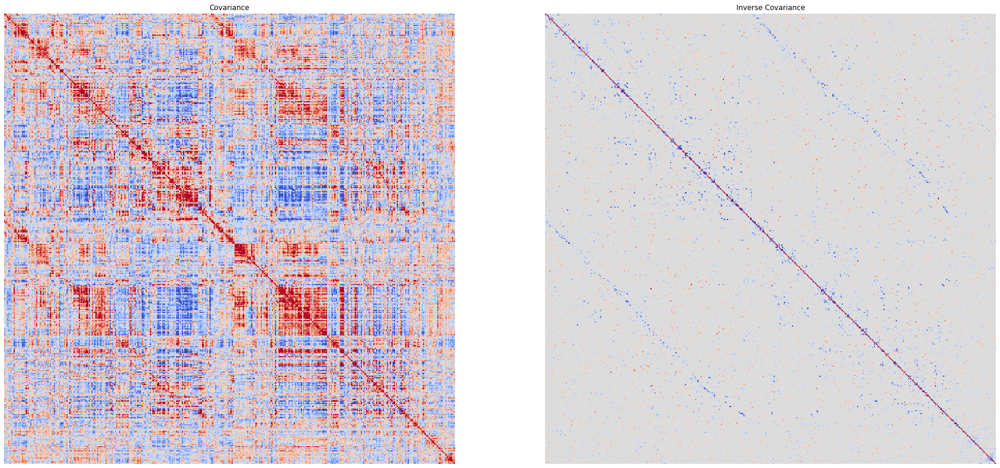

In [23]:
plot_solution(solution=est_uniform["Theta"], name="SGL")

In [25]:
with open('statistics.txt', 'w') as f:
    print(statistics, file=f)

# GGL

In [9]:
N = 436
gamma = 0.3

lambda1_range = [0.18957357, 0.14677993, 0.11364637, 0.08799225]
lambda2_range = np.logspace(-0.5, -2, 10)

In [10]:
P_10 = glasso_problem(sub_corr[:9,:], N, reg_params = {'lambda1_range': lambda1_range, 'lambda2_range': lambda2_range}, 
                      latent = False, do_scaling = False)

In [11]:
modelselect_params = {'lambda1_range': lambda1_range, 'lambda2_range': lambda2_range}

In [12]:
P_10.model_selection(modelselect_params = modelselect_params, method = 'eBIC', gamma = gamma)

ADMM terminated after 111 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 105 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 88 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 75 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 66 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 59 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 55 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 52 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 50 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 48 i

In [13]:
statistics_10 = P_10.modelselect_stats

In [15]:
statistics_10

{'BIC': {0.1: array([[1088924.03588179, 1067821.74095525, 1075857.29123674,
          1105381.85405659],
         [ 998962.02307413,  982409.38875818, 1004065.44686481,
          1051896.51989827],
         [ 901104.19039782,  886925.88379158,  905507.55665758,
           965059.50120969],
         [ 808567.32525603,  779695.94562705,  793859.27522861,
           853573.11912453],
         [ 722710.88041849,  678839.1377078 ,  679611.01772457,
           724506.84629356],
         [ 653231.16598141,  592602.15468027,  575254.66533624,
           598194.58890317],
         [ 599497.55653876,  524687.8890201 ,  487118.38464296,
           490625.25522196],
         [ 559694.75058056,  473656.44668074,  420654.79760347,
           401460.21467756],
         [ 531606.67877815,  435593.87518525,  370384.02542708,
           335169.69339725],
         [ 511754.7872826 ,  408687.89236899,  334536.02255943,
           285568.88250158]]),
  0.5: array([[1562211.91688346, 1677015.42674579, 18255

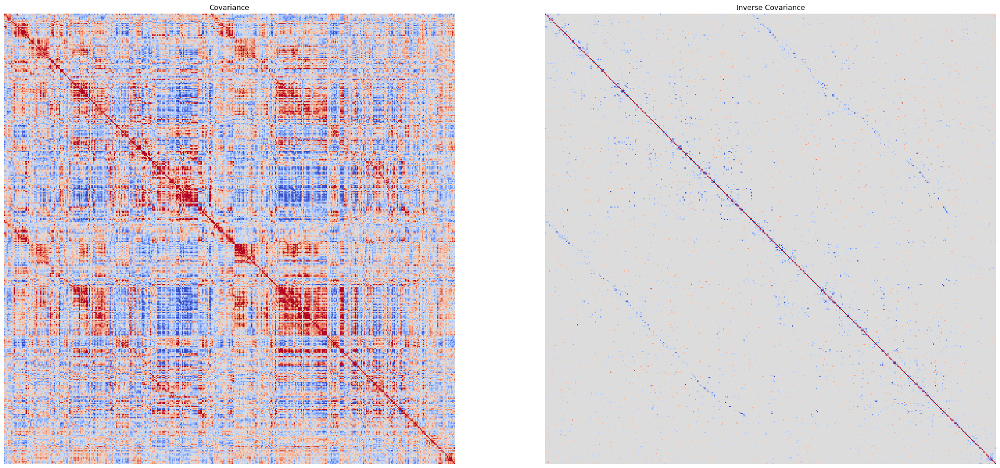

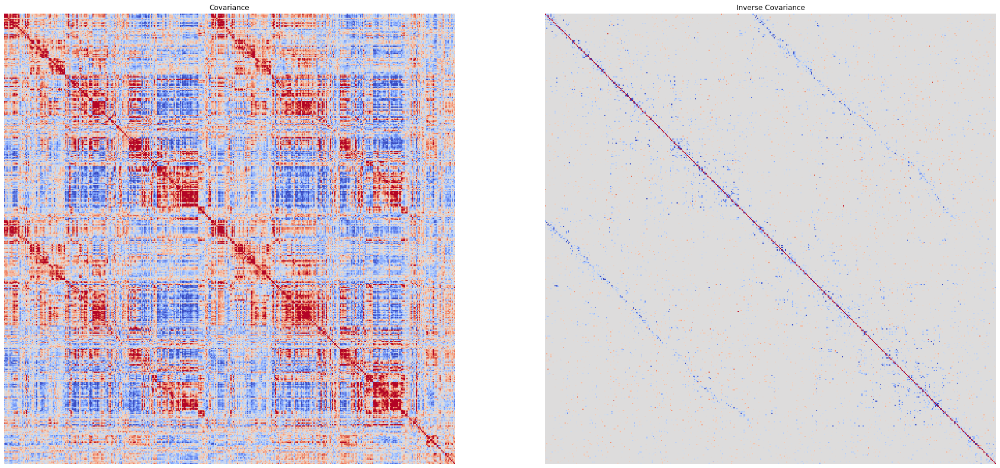

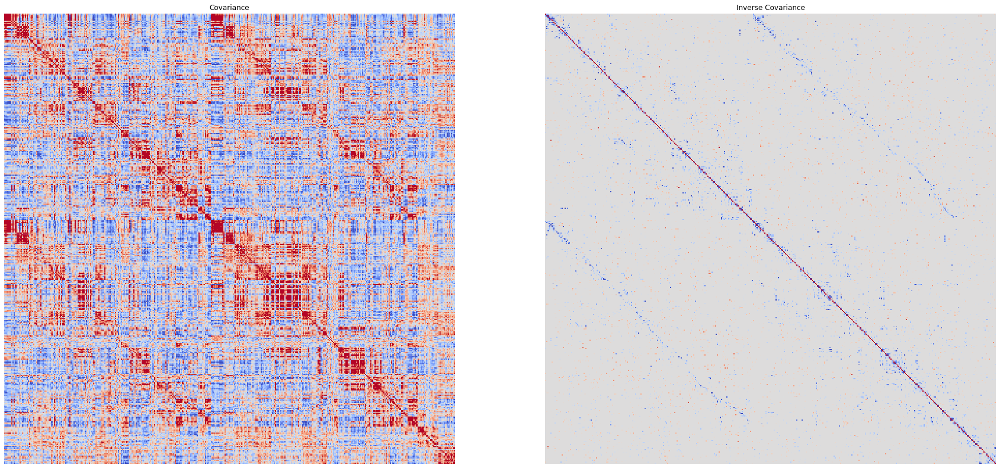

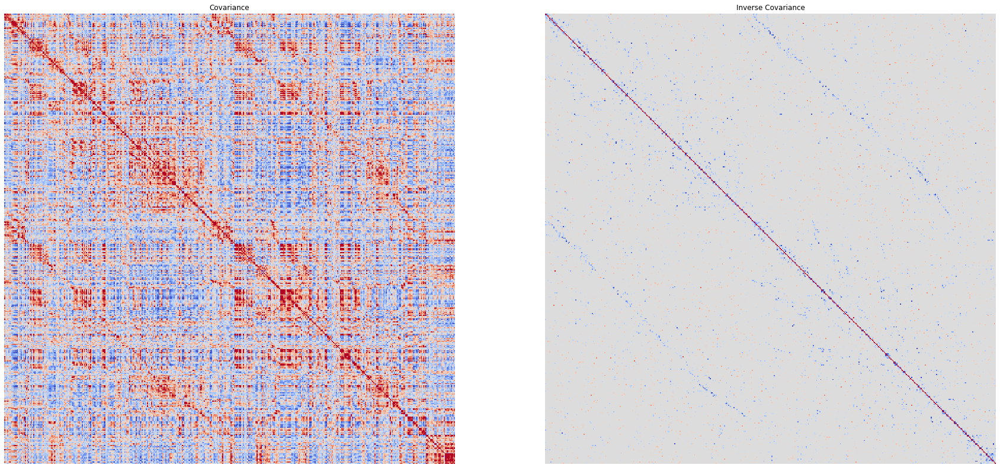

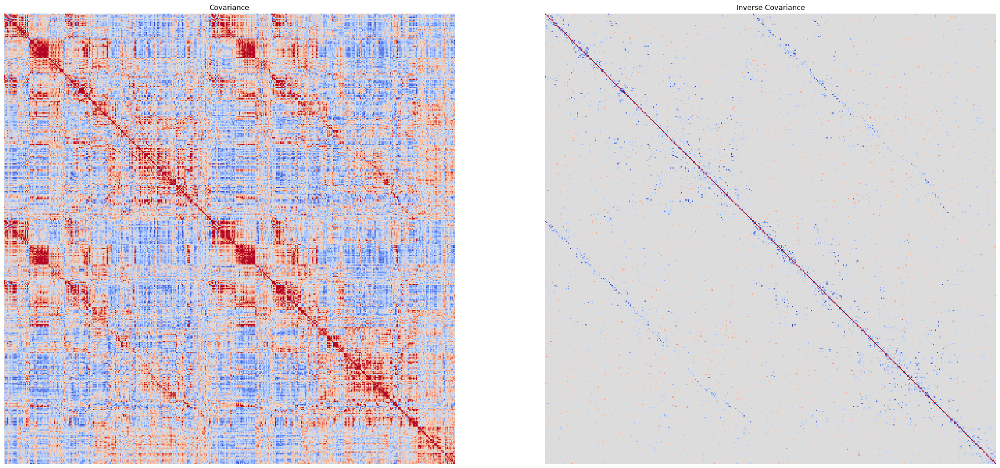

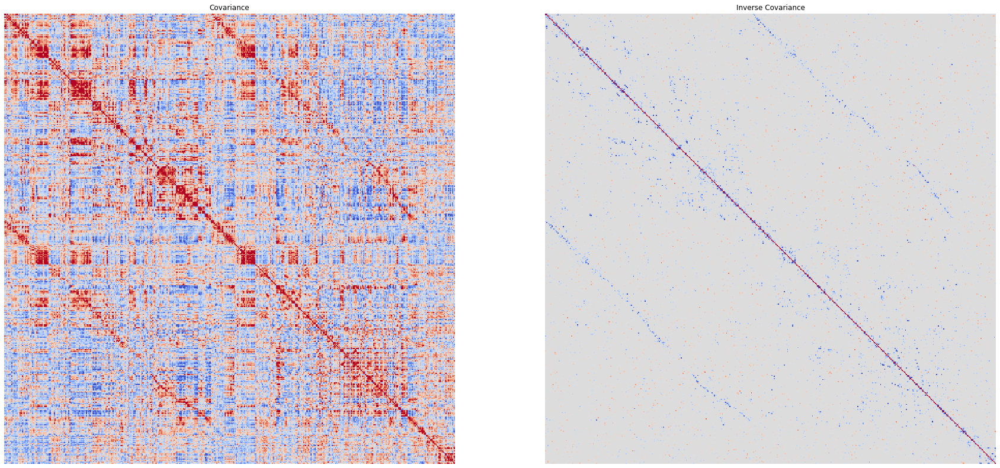

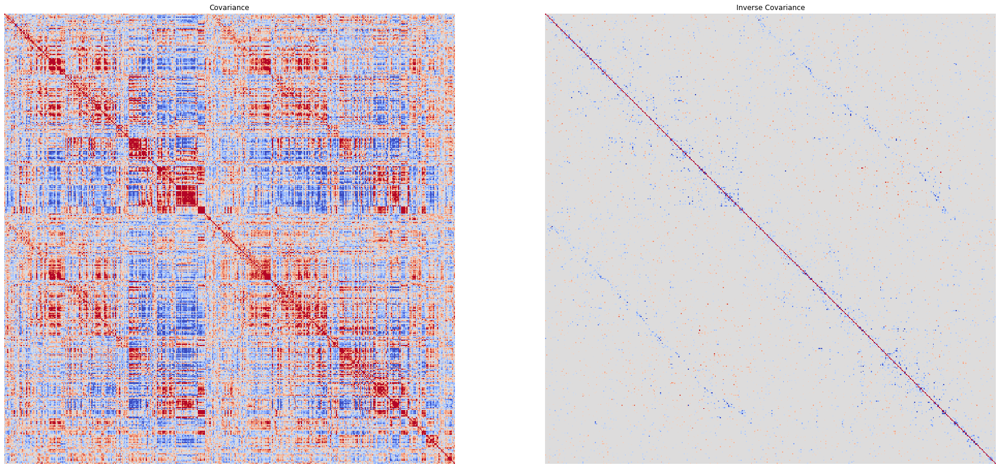

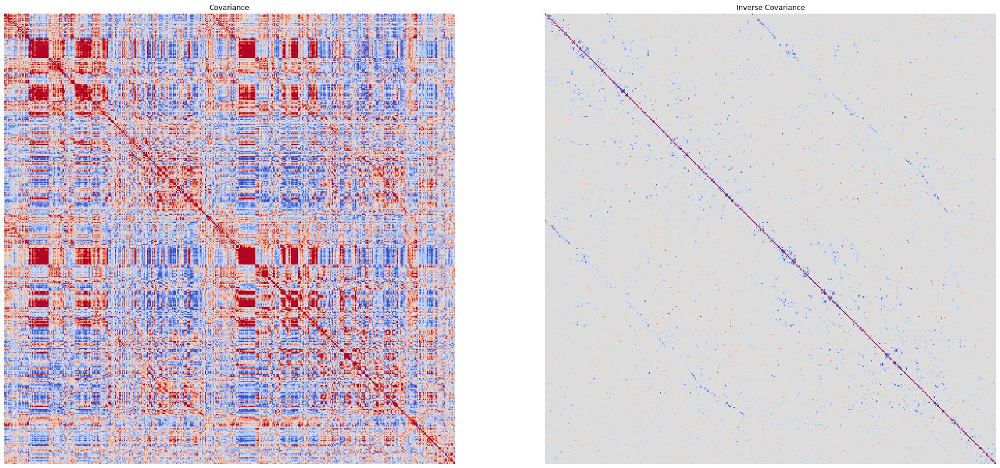

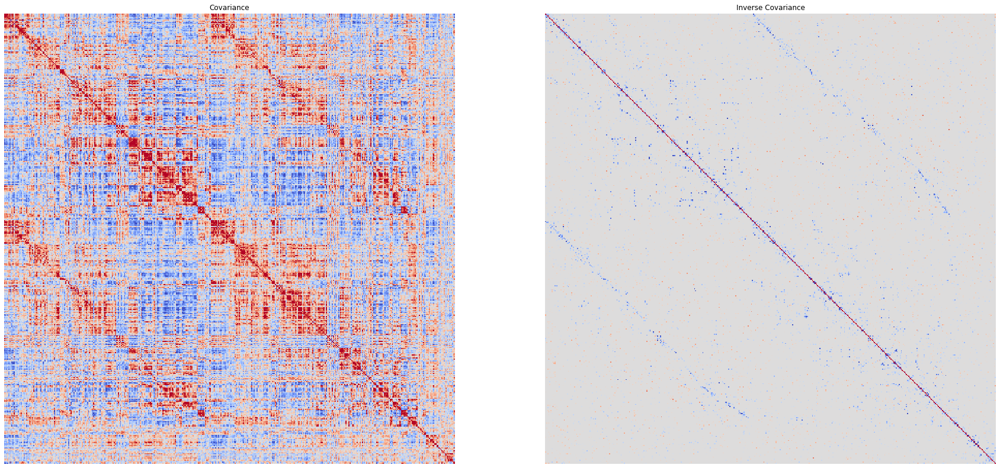

In [14]:
plot_solution(solution=P_10.solution.precision_, name="SGL")

In [ ]:
with open('new_MGL_statistics.txt', 'w') as f:
    print(statistics_10, file=f)

In [26]:
N = 436
gamma = 0.3

lambda1_range = [0.18957357, 0.14677993, 0.11364637]
lambda2_range = [0.01, 0.005, 0.001]
# lambda2_range = np.logspace(-2, -3, 5)

In [27]:
P_10v2 = glasso_problem(sub_corr[:9,:], N, reg_params = {'lambda1_range': lambda1_range, 'lambda2_range': lambda2_range}, 
                      latent = False, do_scaling = False)

In [28]:
modelselect_params = {'lambda1_range': lambda1_range, 'lambda2_range': lambda2_range}

In [29]:
P_10v2.model_selection(modelselect_params = modelselect_params, method = 'eBIC', gamma = gamma)

ADMM terminated after 49 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 47 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 46 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 37 iterations with status: optimal.
ADMM terminated after 33 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 32 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 43 iterations with status: optimal.
ADMM terminated after 31 iterations with status: optimal.
ADMM terminated after 31 iterations with status: optimal.
----------New optimum found in the grid----------


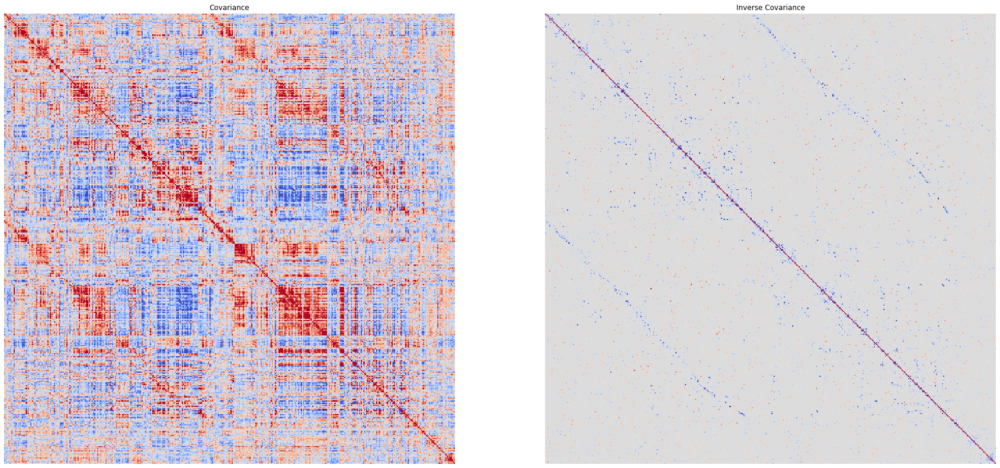

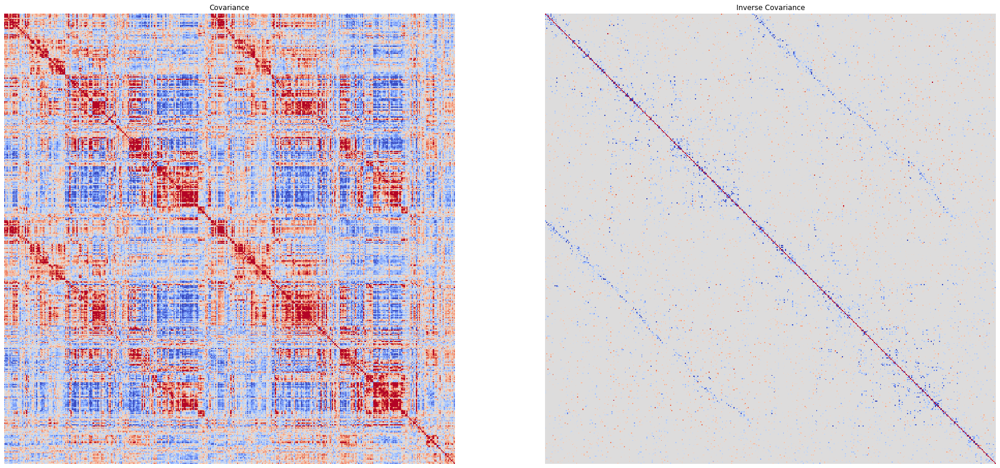

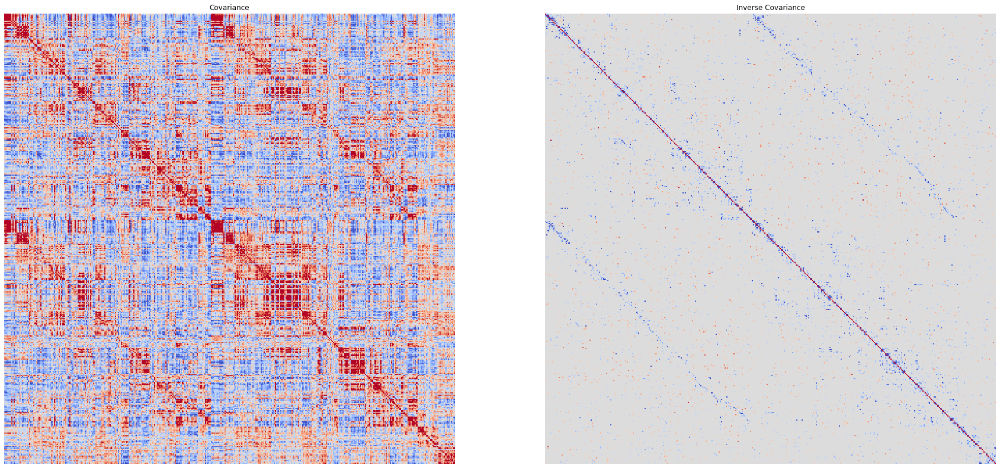

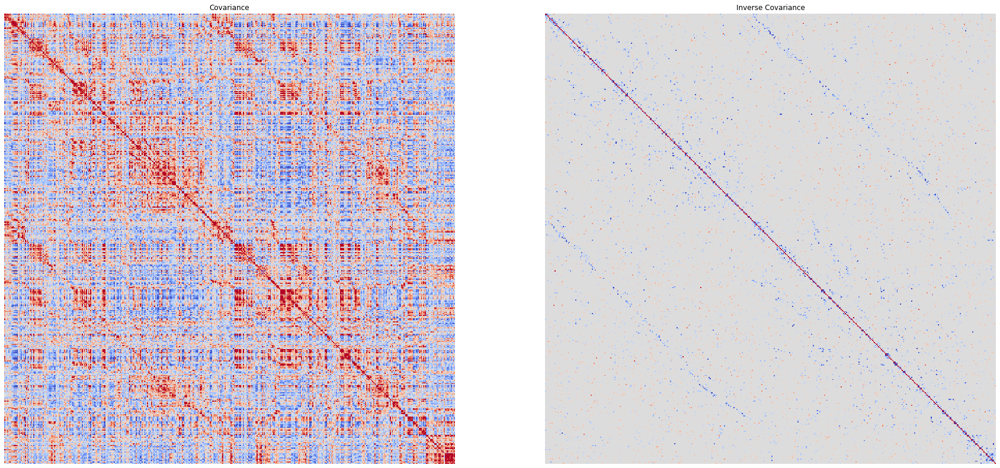

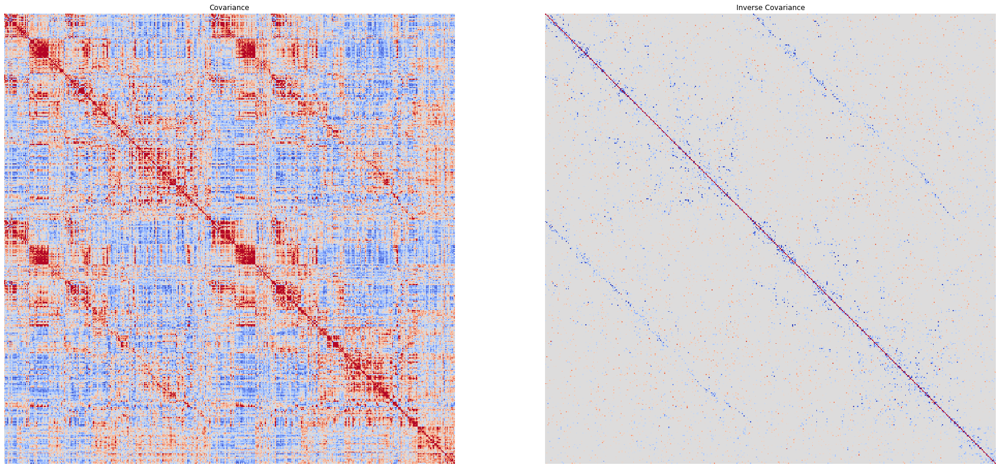

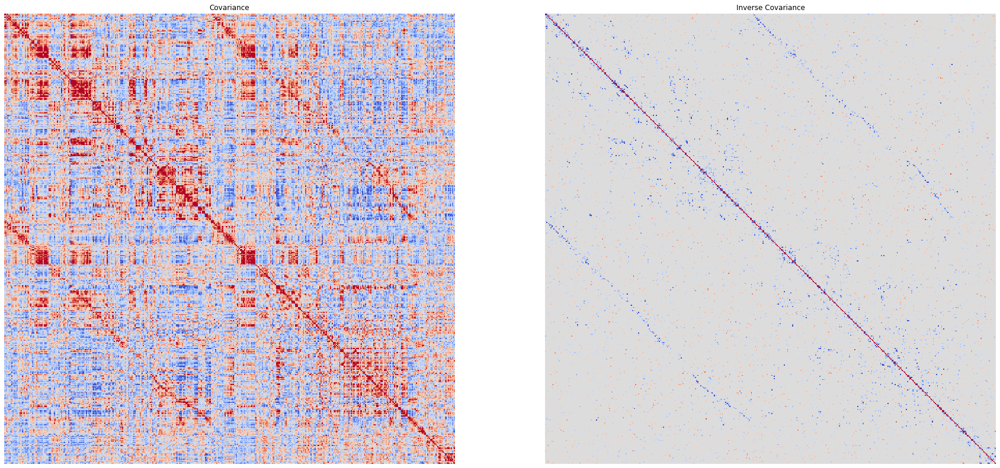

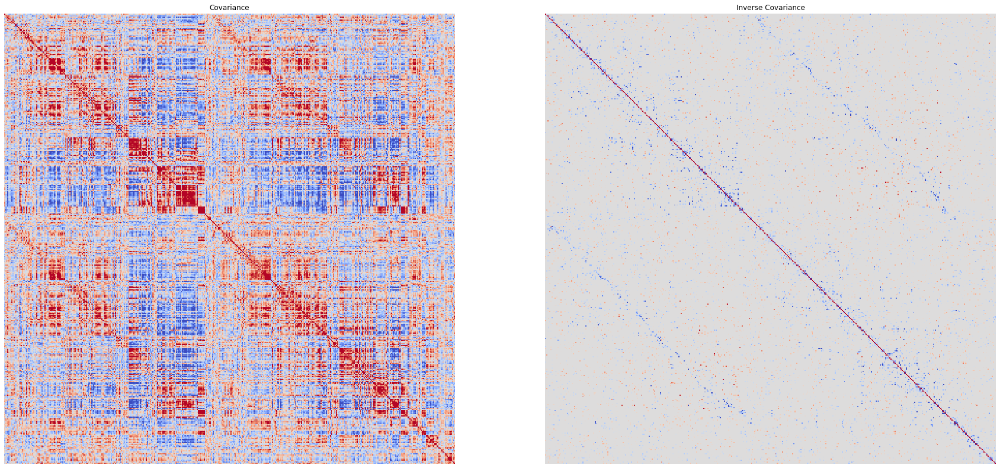

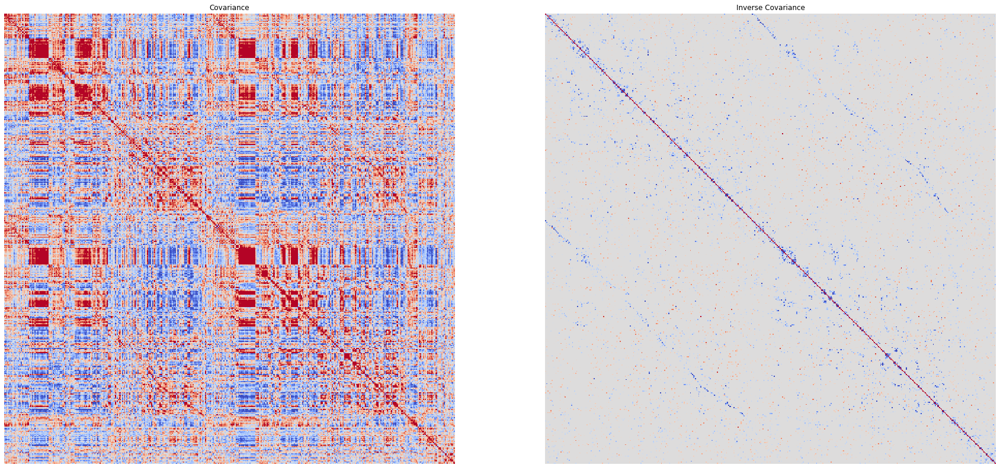

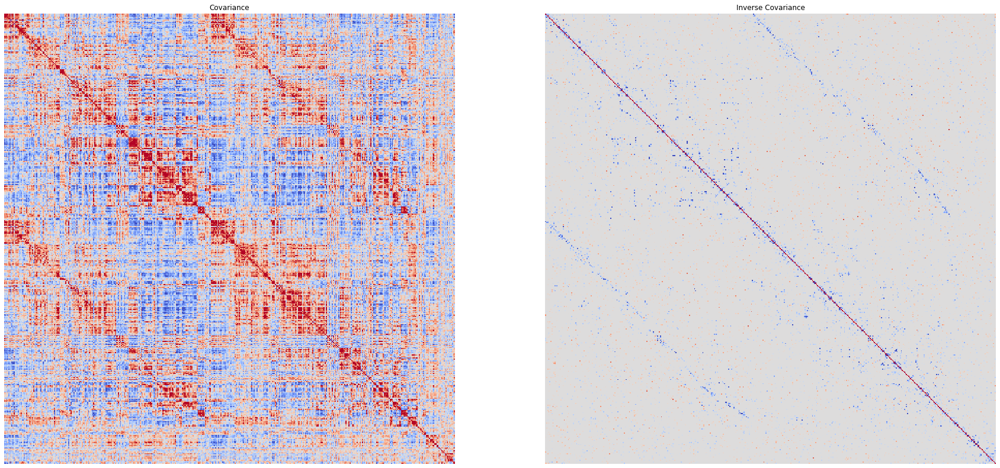

In [30]:
plot_solution(solution=P_10v2.solution.precision_, name="MGL")

In [32]:
statistics_10v2 = P_10v2.modelselect_stats
statistics_10v2

{'BIC': {0.1: array([[512404.69824824, 410606.56920245, 334534.81351754],
         [489667.48757918, 379953.72386948, 294078.62579723],
         [472802.91815555, 356184.52908907, 261197.16534854]]),
  0.5: array([[1087913.65966924, 1114300.29870637, 1192629.8286853 ],
         [1058884.87374987, 1073378.66903905, 1136527.35877371],
         [1038548.75507683, 1042257.95820108, 1091218.33546582]]),
  0.3: array([[800159.17895874, 762453.43395441, 763582.32110142],
         [774276.18066453, 726666.19645426, 715302.99228547],
         [755675.83661619, 699221.24364507, 676207.75040718]]),
  0.7: array([[1375668.14037974, 1466147.16345833, 1621677.33626918],
         [1343493.56683521, 1420091.14162383, 1557751.72526195],
         [1321421.67353747, 1385294.67275708, 1506228.92052446]])},
 'AIC': array([[ 127200.35700487,  -60395.44411349, -239812.32475425],
        [ 108674.27467983,  -84175.10315388, -269796.01555719],
        [  94133.31084942, -103023.72138394, -294359.35850408]]),
 

/home/icb/oleg.vlasovetc/miniconda3/envs/brains/lib/python3.9/site-packages/gglasso/helper/experiment_helper.py:382: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = fig.gca(projection='3d')


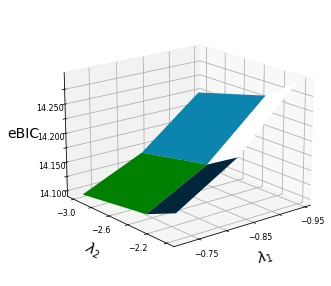

In [33]:
#plot for GGL
fig = surface_plot(statistics_10v2['L1'], statistics_10v2['L2'], statistics_10v2['BIC'][0.7], name = 'eBIC')
fig.savefig("plots/GGL_l1_l2_10v2.png")

In [34]:
N = 436
gamma = 0.3

lambda1_range = [0.18957357, 0.14677993, 0.11364637]
lambda2_range = [0.001, 0.0005, 0.0000001]
# lambda2_range = np.logspace(-2, -3, 5)

In [35]:
P_10v3 = glasso_problem(sub_corr[:9,:], N, reg_params = {'lambda1_range': lambda1_range, 'lambda2_range': lambda2_range}, 
                      latent = False, do_scaling = False)

In [36]:
modelselect_params = {'lambda1_range': lambda1_range, 'lambda2_range': lambda2_range}

In [37]:
P_10v3.model_selection(modelselect_params = modelselect_params, method = 'eBIC', gamma = gamma)

ADMM terminated after 47 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 46 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 45 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 40 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 32 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 32 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 49 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 29 iterations with status: optimal.
----------New optimum found in the grid----------
ADMM terminated after 29 iterations with status: optimal.
----------New optimum found in the grid----------


In [38]:
statistics_10v3 = P_10v3.modelselect_stats
statistics_10v3

{'BIC': {0.1: array([[473709.58110842, 357540.75334831, 260127.09967499],
         [470568.0012286 , 352932.91313351, 257170.10177008],
         [468490.96342637, 349551.54352798, 252093.08936039]]),
  0.5: array([[1039834.66290569, 1044255.98148121, 1088057.56086056],
         [1035769.28140488, 1037946.40143827, 1086267.47026637],
         [1033215.75645077, 1033417.57297721, 1078944.16128354]]),
  0.3: array([[756772.12200706, 700898.36741476, 674092.33026778],
         [753168.64131674, 695439.65728589, 671718.78601822],
         [750853.35993857, 691484.55825259, 665518.62532197]]),
  0.7: array([[1322897.20380433, 1387613.59554766, 1502022.79145334],
         [1318369.92149302, 1380453.14559066, 1500816.15451451],
         [1315578.15296297, 1375350.58770182, 1492369.69724511]])},
 'AIC': array([[  94786.13453581, -102097.07126799, -294030.05386238],
        [  92262.88107435, -105565.88913316, -297768.09566418],
        [  90504.76953002, -108179.23224009, -301341.59857236]]),
 

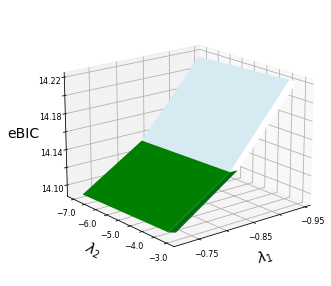

In [39]:
#plot for GGL
fig = surface_plot(statistics_10v3['L1'], statistics_10v3['L2'], statistics_10v3['BIC'][0.7], name = 'eBIC')
fig.savefig("plots/GGL_l1_l2_10v3.png")